# Geospatial Routs plotting for New York CitiBike 2022 

## Loading Libraries 

In [1]:
import pandas as pd
import os
import numpy as np
import seaborn as sns
from matplotlib import pyplot as plt
import pydeck as pdk
import ipywidgets as widgets

In [2]:
from dotenv import load_dotenv 
import os  
load_dotenv() 

True

In [3]:
load_dotenv()

SAVE_PATH = os.getenv("SAVE_PATH")


### Load the unique aggrigated Trips table after cleaning the missing coordinates 

In [4]:
# Get the full file path from .env
trips_df_path = os.getenv("TRIPS_DF")

# Read the CSV directly
trips_df=pd.read_csv(trips_df_path)

In [4]:
trips_df.shape

(5035534, 8)

In [5]:
trips_df.head()

,Unnamed: 0,start_station_name,start_lat,start_lng,end_station_name,end_lat,end_lng,trip_count
0,1392527,Central Park S & 6 Ave,40.765909,-73.976342,Central Park S & 6 Ave,40.765909,-73.976342,10658
1,3736637,Roosevelt Island Tramway,40.757284,-73.953600,Roosevelt Island Tramway,40.757284,-73.953600,7862
2,637350,7 Ave & Central Park South,40.766741,-73.979069,7 Ave & Central Park South,40.766741,-73.979069,7378
3,3821375,Soissons Landing,40.692317,-74.014866,Soissons Landing,40.692317,-74.014866,6731
4,4294953,W 21 St & 6 Ave,40.741740,-73.994156,9 Ave & W 22 St,40.745497,-74.001971,5987


In [5]:
trips_df = trips_df.drop(columns=["Unnamed: 0"])

In [6]:
trips_df.isna().sum()

start_station_name    0
start_lat             0
start_lng             0
end_station_name      0
end_lat               0
end_lng               0
trip_count            0
dtype: int64

## Descriptive statistics

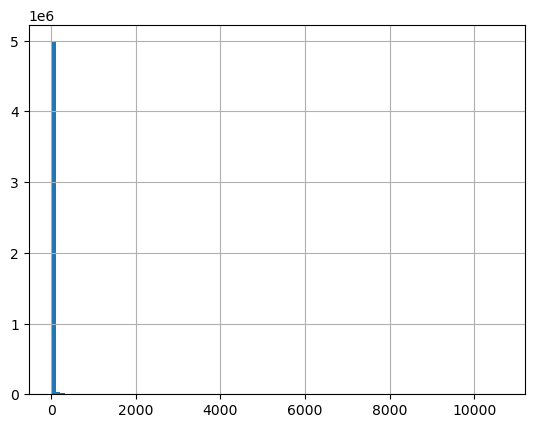

In [15]:
trips_df['trip_count'].hist(bins = 100)
plt.show()

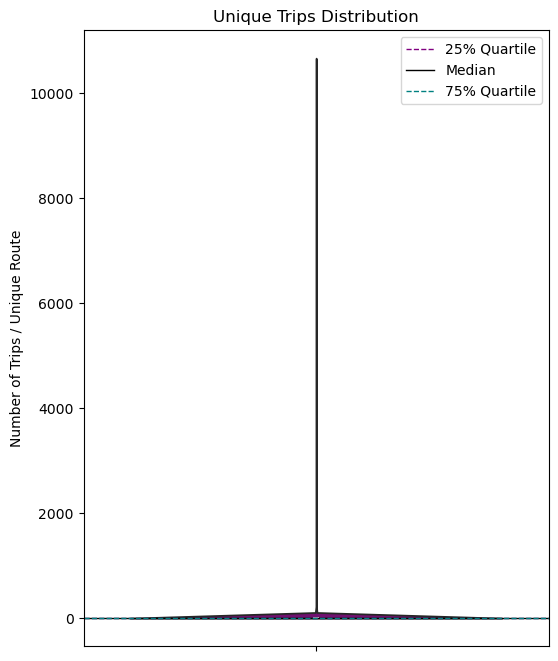

In [28]:
plt.figure(figsize=(6, 8))

# --- Violin plot ---
sns.violinplot(
    y=trips_df['trip_count'],
    color='purple'
)

# --- Compute quartiles ---
q25 = np.percentile(trips_df['trip_count'], 25)
q75 = np.percentile(trips_df['trip_count'], 75)
median = np.percentile(trips_df['trip_count'], 50)

# --- Add horizontal lines for quartiles ---
plt.axhline(q25, color='purple', linestyle='--', linewidth=1, label='25% Quartile')
plt.axhline(median, color='black', linestyle='-', linewidth=1, label='Median')
plt.axhline(q75, color='teal', linestyle='--', linewidth=1, label='75% Quartile')

# --- Labels & Title ---
plt.title('Unique Trips Distribution')
plt.ylabel('Number of Trips / Unique Route')

# --- Legend ---
plt.legend()

# --- Save plot ---
plt.savefig(os.path.join(SAVE_PATH, "Unique Trips Distribution.png"),
            dpi=600, bbox_inches='tight')

plt.show()

In [ ]:
import gc
gc.collect()

In [17]:
trips_df.describe()

,start_lat,start_lng,end_lat,end_lng,trip_count
count,5.035534e+06,5.035534e+06,5.035534e+06,5.035534e+06,5.035534e+06
mean,4.074628e+01,-7.396771e+01,4.074614e+01,-7.396769e+01,5.918130e+00
std,4.704049e-02,2.992810e-02,4.713587e-02,3.001963e-02,4.119916e+01
min,4.062737e+01,-7.402802e+01,4.056000e+01,-7.428000e+01,1.000000e+00
25%,4.071421e+01,-7.399041e+01,4.071419e+01,-7.399046e+01,1.000000e+00
50%,4.074346e+01,-7.397570e+01,4.074323e+01,-7.397567e+01,1.000000e+00
75%,4.077263e+01,-7.394899e+01,4.077260e+01,-7.394885e+01,1.000000e+00
max,4.088398e+01,-7.387859e+01,4.106000e+01,-7.375000e+01,1.065800e+04


Histogram and Violonplot and top20 trips show that the data is right skewed and that there is one trip path with the maximum trip number 12,041. i.e, this station is very popular and is being used for round trips.
QC: to be sure that those are round trips, the duration time should be checked, Negative and extreme durations should be cleaned out and then look at the trips again.

In [8]:
top20_trips = trips_df.iloc[:20].reset_index(drop=True)

In [9]:
# Create a Trip label combining start → end
top20_trips['route'] = top20_trips['start_station_name'] + " → " + top20_trips['end_station_name']

In [10]:
top20_trips

,start_station_name,start_lat,start_lng,end_station_name,end_lat,end_lng,trip_count,route
0,Central Park S & 6 Ave,40.765909,-73.976342,Central Park S & 6 Ave,40.765909,-73.976342,10658,Central Park S & 6 Ave → Central Park S & 6 Ave
1,Roosevelt Island Tramway,40.757284,-73.953600,Roosevelt Island Tramway,40.757284,-73.953600,7862,Roosevelt Island Tramway → Roosevelt Island Tr...
2,7 Ave & Central Park South,40.766741,-73.979069,7 Ave & Central Park South,40.766741,-73.979069,7378,7 Ave & Central Park South → 7 Ave & Central P...
3,Soissons Landing,40.692317,-74.014866,Soissons Landing,40.692317,-74.014866,6731,Soissons Landing → Soissons Landing
4,W 21 St & 6 Ave,40.741740,-73.994156,9 Ave & W 22 St,40.745497,-74.001971,5987,W 21 St & 6 Ave → 9 Ave & W 22 St
5,Grand Army Plaza & Central Park S,40.764397,-73.973715,Grand Army Plaza & Central Park S,40.764397,-73.973715,5858,Grand Army Plaza & Central Park S → Grand Army...
6,1 Ave & E 62 St,40.761227,-73.960940,1 Ave & E 68 St,40.765005,-73.958185,5479,1 Ave & E 62 St → 1 Ave & E 68 St
7,5 Ave & E 72 St,40.772828,-73.966853,5 Ave & E 72 St,40.772828,-73.966853,5318,5 Ave & E 72 St → 5 Ave & E 72 St
8,12 Ave & W 40 St,40.760875,-74.002777,12 Ave & W 40 St,40.760875,-74.002777,4979,12 Ave & W 40 St → 12 Ave & W 40 St
9,Yankee Ferry Terminal,40.687066,-74.016756,Yankee Ferry Terminal,40.687066,-74.016756,4846,Yankee Ferry Terminal → Yankee Ferry Terminal


In [9]:
# save
top20_trips.to_csv("top20_trips.csv", index=False)

C:\Users\analy\AppData\Local\Temp\ipykernel_14216\1864928601.py:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(


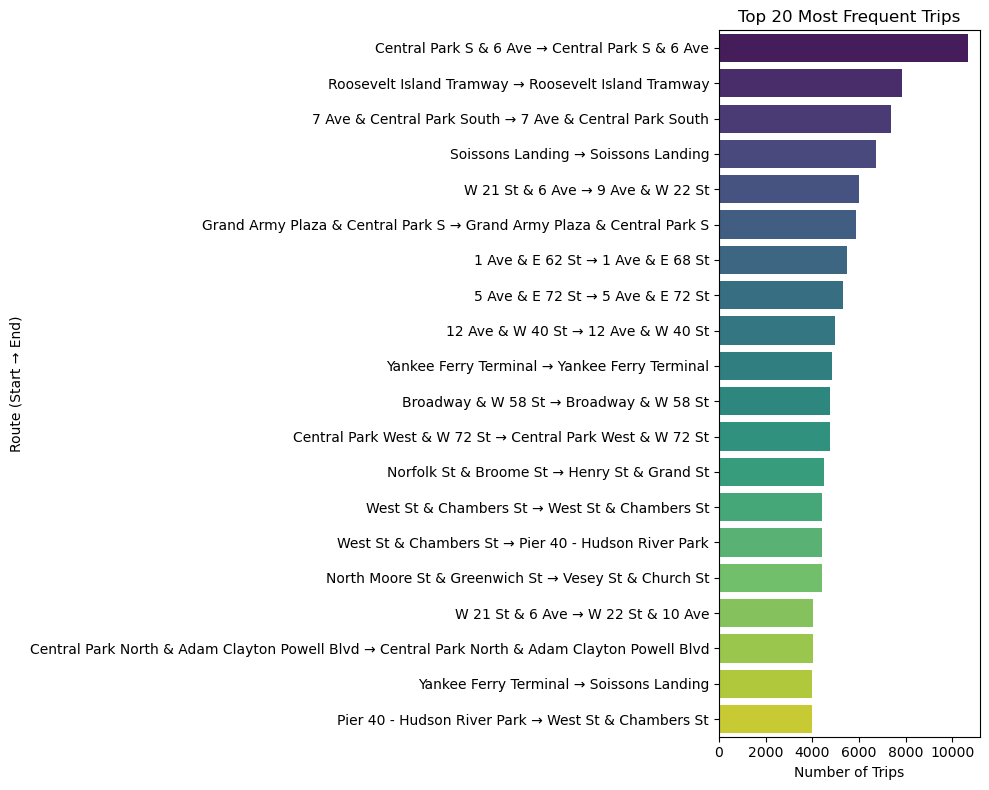

In [16]:
plt.figure(figsize=(10, 8))

sns.barplot(
    data=top20_trips,
    y='route',
    x='trip_count',
    palette='viridis'   # or 'crest', 'mako', 'Greens'
)

plt.title('Top 20 Most Frequent Trips')
plt.xlabel('Number of Trips')
plt.ylabel('Route (Start → End)')

# Save plot
plt.savefig(os.path.join(SAVE_PATH, "top20 Trips.png"),dpi=300,bbox_inches='tight')

plt.tight_layout()
plt.show()

## Pydeck visualization of City Bike 2022 Routs

In [7]:
Top100_Routes = trips_df.nlargest(100, "trip_count")

In [10]:
# --- Prepare coordinates ---
Top100_Routes["start_coords"] = Top100_Routes[["start_lng", "start_lat"]].values.tolist()
Top100_Routes["end_coords"] = Top100_Routes[["end_lng", "end_lat"]].values.tolist()

# --- Widgets ---
width_slider = widgets.FloatSlider(
    value=3, min=1, max=20, step=1, description="Arc Width"
)

opacity_slider = widgets.FloatSlider(
    value=0.6, min=0.1, max=1.0, step=0.1, description="Opacity"
)

pitch_slider = widgets.IntSlider(
    value=45, min=0, max=60, step=5, description="Pitch"
)

zoom_slider = widgets.FloatSlider(
    value=12, min=9, max=15, step=0.1, description="Zoom"
)

# --- Interactive update function ---
def update_map(width, opacity, pitch, zoom):

    layer = pdk.Layer(
        "ArcLayer",
        Top100_Routes,
        get_source_position="start_coords",
        get_target_position="end_coords",
        get_width=width,
        get_source_color=[0, 128, 255, int(opacity * 255)],
        get_target_color=[255, 0, 80, int(opacity * 255)],
        pickable=True,
        auto_highlight=True,
    )

    view_state = pdk.ViewState(
        latitude=Top100_Routes["start_lat"].mean(),
        longitude=Top100_Routes["start_lng"].mean(),
        zoom=zoom,
        pitch=pitch,
    )

    return pdk.Deck(
        layers=[layer],
        initial_view_state=view_state,
        tooltip={
            "text": "{start_station_name} → {end_station_name}\nTrips: {trip_count}"
        }
    )

# --- Display interactive map ---
widgets.interact(
    update_map,
    width=width_slider,
    opacity=opacity_slider,
    pitch=pitch_slider,
    zoom=zoom_slider
)

interactive(children=(FloatSlider(value=3.0, description='Arc Width', max=20.0, min=1.0, step=1.0), FloatSlide…

<function __main__.update_map(width, opacity, pitch, zoom)>

In [ ]:
# Create a Deck object using the current slider values
final_deck = update_map(
    width=width_slider.value,
    opacity=opacity_slider.value,
    pitch=pitch_slider.value,
    zoom=zoom_slider.value
)

# Save to HTML (no browser opening)
final_deck.to_html("top50_routes_directional.html", open_browser=False)

In [8]:
trips_df2 = trips_df.sample(n=50_000, random_state=42)

In [21]:
pdk.settings.custom_libraries = []

In [ ]:
# Create coordinate pairs directly on your dataframe
trips_df2["start_coords"] = trips_df2[["start_lng", "start_lat"]].values.tolist()
trips_df2["end_coords"] = trips_df2[["end_lng", "end_lat"]].values.tolist()

# --- Widgets ---
width_slider = widgets.FloatSlider(
    value=10, min=1, max=30, step=1, description="Max Line Width"
)

opacity_slider = widgets.FloatSlider(
    value=0.6, min=0.1, max=1.0, step=0.1, description="Opacity"
)

min_trips_slider = widgets.IntSlider(
    value=0, min=0, max=int(trips_df2["trip_count"].max()), step=1,
    description="Min Trips"
)

pitch_slider = widgets.IntSlider(
    value=45, min=0, max=60, step=5, description="Pitch"
)

zoom_slider = widgets.FloatSlider(
    value=12, min=9, max=15, step=0.1, description="Zoom"
)

# --- Interactive update function ---
def update_map2(max_width, opacity, min_trips, pitch, zoom):

    # Filter data
    df = trips_df2[trips_df2["trip_count"] >= min_trips].copy()

    # Recompute scaled width based on widget
    df["line_width"] = df["trip_count"] / df["trip_count"].max() * max_width

    # Build layer
    route_layer = pdk.Layer(
        "LineLayer",
        df,
        get_source_position="start_coords",
        get_target_position="end_coords",
        get_width="line_width",
        get_color=[0, 128, 255, int(opacity * 255)],
        pickable=True,
        auto_highlight=True,
    )

    # View state
    view_state = pdk.ViewState(
        latitude=df["start_lat"].mean(),
        longitude=df["start_lng"].mean(),
        zoom=zoom,
        pitch=pitch,
    )

    # Return deck object for rendering
    return pdk.Deck(
        layers=[route_layer],
        initial_view_state=view_state,
        tooltip={
            "text": "{start_station_name} → {end_station_name}\nTrips: {trip_count}"
        }
    )

# --- Display interactive map ---
widgets.interact(
    update_map,
    max_width=width_slider,
    opacity=opacity_slider,
    min_trips=min_trips_slider,
    pitch=pitch_slider,
    zoom=zoom_slider
)

In [36]:
final_deck2 = update_map2(
    max_width=width_slider.value,
    opacity=opacity_slider.value,
    min_trips=min_trips_slider.value,
    pitch=pitch_slider.value,
    zoom=zoom_slider.value
)

final_deck2.to_html("100,000_routes_map.html", open_browser=False)